In [83]:
# credit @https://www.kaggle.com/code/rodsaldanha/stock-prediction-pytorch
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go2
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import math, time
from sklearn.metrics import mean_squared_error

from utils import get_order_book

import os
import warnings
warnings.filterwarnings("ignore")

In [41]:
data = None
date_idx = []
date_plot_idx = []

In [42]:
for dirname, _, filenames in os.walk('./data/'):
    filenames = sorted(filenames)
    for filename in filenames:
        print(filename)
        path = os.path.join(dirname, filename)
        trade_book = get_order_book(path)
        date_idx.append(len(trade_book))
        if len(date_plot_idx) == 0:
            date_plot_idx.append(len(trade_book))
        else:
            date_plot_idx.append(len(trade_book) + date_plot_idx[-1])
        if data is None:
            data = trade_book
        else:
            data = pd.concat([data, trade_book], ignore_index=True)

tick_SPY_20220401.txt
tick_SPY_20220404.txt
tick_SPY_20220405.txt
tick_SPY_20220406.txt
tick_SPY_20220407.txt
tick_SPY_20220408.txt
tick_SPY_20220411.txt
tick_SPY_20220412.txt
tick_SPY_20220413.txt
tick_SPY_20220414.txt
tick_SPY_20220418.txt
tick_SPY_20220419.txt
tick_SPY_20220420.txt
tick_SPY_20220421.txt
tick_SPY_20220422.txt
tick_SPY_20220425.txt
tick_SPY_20220426.txt
tick_SPY_20220427.txt
tick_SPY_20220428.txt
tick_SPY_20220429.txt
tick_SPY_20220502.txt
tick_SPY_20220503.txt
tick_SPY_20220504.txt
tick_SPY_20220505.txt
tick_SPY_20220506.txt
tick_SPY_20220509.txt
tick_SPY_20220510.txt
tick_SPY_20220511.txt
tick_SPY_20220512.txt
tick_SPY_20220513.txt


In [43]:
data.head()

,Date1,id,Type,Source,Quantity,Price
0,2022-04-01 13:01:14.495514880,102116,T,IEX,200,453.21
1,2022-04-01 13:30:00.270296064,190872,T,IEX,10,453.30
2,2022-04-01 13:30:00.282213120,192077,T,IEX,90,453.30
3,2022-04-01 13:30:00.282214912,192080,T,IEX,10,453.30
4,2022-04-01 13:30:00.648529920,217146,T,IEX,300,453.28


In [61]:
new_date_plot_idx = [x - 1 for x in date_plot_idx]

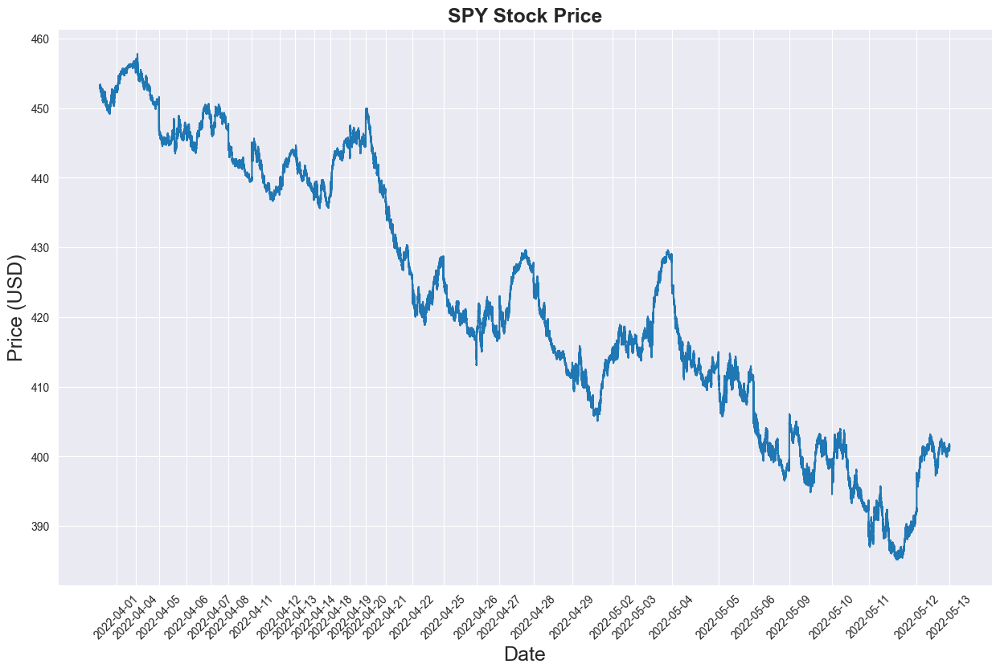

In [62]:
sns.set_style("darkgrid")
plt.figure(figsize = (15,9))
plt.plot(data[['Price']])
plt.xticks(date_plot_idx,data['Date1'].loc[new_date_plot_idx].apply(lambda s : s.split(" ")[0]),rotation=45)
plt.title("SPY Stock Price",fontsize=18, fontweight='bold')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Price (USD)',fontsize=18)
plt.savefig("./assets/SPY_april1_may15.png")
plt.show()

## Normalize data

In [45]:
price = data[['Price']]
price.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 458236 entries, 0 to 458235
Data columns (total 1 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Price   458236 non-null  float64
dtypes: float64(1)
memory usage: 3.5 MB


In [46]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(-1, 1))
price['Price'] = scaler.fit_transform(price['Price'].values.reshape(-1,1))

In [47]:
def split_data(stock, lookback):
    data_raw = stock.to_numpy() # convert to numpy array
    data = []
    
    # create all possible sequences of length seq_len
    for index in range(len(data_raw) - lookback): 
        data.append(data_raw[index: index + lookback])
    
    data = np.array(data);
    test_set_size = int(np.round(0.2*data.shape[0]));
    train_set_size = data.shape[0] - (test_set_size);
    
    x_train = data[:train_set_size,:-1,:]
    y_train = data[:train_set_size,-1,:]
    
    x_test = data[train_set_size:,:-1]
    y_test = data[train_set_size:,-1,:]
    
    return [x_train, y_train, x_test, y_test]

In [48]:
lookback = 20 # choose sequence length
x_train, y_train, x_test, y_test = split_data(price, lookback)
print('x_train.shape = ',x_train.shape)
print('y_train.shape = ',y_train.shape)
print('x_test.shape = ',x_test.shape)
print('y_test.shape = ',y_test.shape)

x_train.shape =  (366573, 19, 1)
y_train.shape =  (366573, 1)
x_test.shape =  (91643, 19, 1)
y_test.shape =  (91643, 1)


In [49]:


x_train = torch.from_numpy(x_train).type(torch.Tensor)
x_test = torch.from_numpy(x_test).type(torch.Tensor)
y_train_lstm = torch.from_numpy(y_train).type(torch.Tensor)
y_test_lstm = torch.from_numpy(y_test).type(torch.Tensor)
y_train_gru = torch.from_numpy(y_train).type(torch.Tensor)
y_test_gru = torch.from_numpy(y_test).type(torch.Tensor)

In [50]:
input_dim = 1
hidden_dim = 32
num_layers = 2
output_dim = 1
num_epochs = 100

In [51]:
class LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_layers, output_dim):
        super(LSTM, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).requires_grad_()
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).requires_grad_()
        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))
        out = self.fc(out[:, -1, :]) 
        return out

In [52]:
model = LSTM(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=output_dim, num_layers=num_layers)
criterion = torch.nn.MSELoss(reduction='mean')
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)

In [53]:
import time

hist = np.zeros(num_epochs)
start_time = time.time()
lstm = []

for t in range(num_epochs):
    y_train_pred = model(x_train)

    loss = criterion(y_train_pred, y_train_lstm)
    print("Epoch ", t, "MSE: ", loss.item())
    hist[t] = loss.item()

    optimiser.zero_grad()
    loss.backward()
    optimiser.step()
    
training_time = time.time()-start_time
print("Training time: {}".format(training_time))

Epoch  0 MSE:  0.29865312576293945
Epoch  1 MSE:  0.2156379222869873
Epoch  2 MSE:  0.16391009092330933
Epoch  3 MSE:  0.1804278939962387
Epoch  4 MSE:  0.13779231905937195
Epoch  5 MSE:  0.11443540453910828
Epoch  6 MSE:  0.10060708969831467
Epoch  7 MSE:  0.06783133000135422
Epoch  8 MSE:  0.02510850317776203
Epoch  9 MSE:  0.06512401252985
Epoch  10 MSE:  0.014569778926670551
Epoch  11 MSE:  0.022221673280000687
Epoch  12 MSE:  0.03910835459828377
Epoch  13 MSE:  0.024616476148366928
Epoch  14 MSE:  0.010129011236131191
Epoch  15 MSE:  0.008907189592719078
Epoch  16 MSE:  0.012787215411663055
Epoch  17 MSE:  0.013962347991764545
Epoch  18 MSE:  0.011353394016623497
Epoch  19 MSE:  0.008937281556427479
Epoch  20 MSE:  0.00908028706908226
Epoch  21 MSE:  0.010791465640068054
Epoch  22 MSE:  0.012035435996949673
Epoch  23 MSE:  0.011676601134240627
Epoch  24 MSE:  0.009916579350829124
Epoch  25 MSE:  0.007831300608813763
Epoch  26 MSE:  0.00654735928401351
Epoch  27 MSE:  0.00647229235

In [63]:
predict = pd.DataFrame(scaler.inverse_transform(y_train_pred.detach().numpy()))
original = pd.DataFrame(scaler.inverse_transform(y_train_lstm.detach().numpy()))

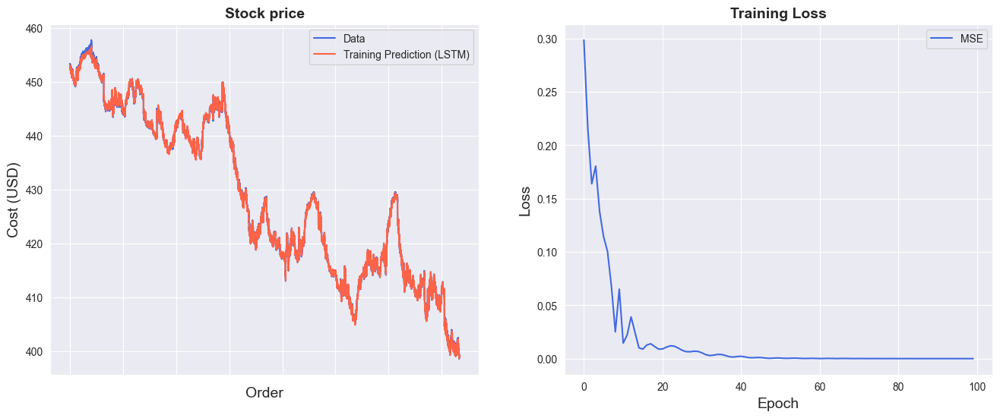

In [66]:
import seaborn as sns
sns.set_style("darkgrid")    

fig = plt.figure()
fig.subplots_adjust(hspace=0.2, wspace=0.2)

plt.subplot(1, 2, 1)
ax = sns.lineplot(x = original.index, y = original[0], label="Data", color='royalblue')
ax = sns.lineplot(x = predict.index, y = predict[0], label="Training Prediction (LSTM)", color='tomato')
ax.set_title('Stock price', size = 14, fontweight='bold')
ax.set_xlabel("Order", size = 14)
ax.set_ylabel("Cost (USD)", size = 14)
ax.set_xticklabels('', size=10)


plt.subplot(1, 2, 2)
ax = sns.lineplot(data=hist, color='royalblue', label="MSE")
ax.set_xlabel("Epoch", size = 14)
ax.set_ylabel("Loss", size = 14)
ax.set_title("LSTM Training Loss", size = 14, fontweight='bold')
fig.set_figheight(6)
fig.set_figwidth(16)

fig.savefig("./assets/prediction_loss.png")

In [67]:
import math, time
from sklearn.metrics import mean_squared_error

# make predictions
y_test_pred = model(x_test)

# invert predictions
y_train_pred = scaler.inverse_transform(y_train_pred.detach().numpy())
y_train = scaler.inverse_transform(y_train_lstm.detach().numpy())
y_test_pred = scaler.inverse_transform(y_test_pred.detach().numpy())
y_test = scaler.inverse_transform(y_test_lstm.detach().numpy())

# calculate root mean squared error
trainScore = math.sqrt(mean_squared_error(y_train[:,0], y_train_pred[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(y_test[:,0], y_test_pred[:,0]))
print('Test Score: %.2f RMSE' % (testScore))
lstm.append(trainScore)
lstm.append(testScore)
lstm.append(training_time)

Train Score: 0.17 RMSE
Test Score: 1.37 RMSE


In [68]:
# shift train predictions for plotting
trainPredictPlot = np.empty_like(price)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[lookback:len(y_train_pred)+lookback, :] = y_train_pred

# shift test predictions for plotting
testPredictPlot = np.empty_like(price)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(y_train_pred)+lookback-1:len(price)-1, :] = y_test_pred

original = scaler.inverse_transform(price['Price'].values.reshape(-1,1))

predictions = np.append(trainPredictPlot, testPredictPlot, axis=1)
predictions = np.append(predictions, original, axis=1)
result = pd.DataFrame(predictions)

In [73]:


fig = go2.Figure()
fig.add_trace(go2.Scatter(go2.Scatter(x=result.index, y=result[0],
                    mode='lines',
                    name='Train prediction')))
fig.add_trace(go2.Scatter(x=result.index, y=result[1],
                    mode='lines',
                    name='Test prediction'))
fig.add_trace(go2.Scatter(go2.Scatter(x=result.index, y=result[2],
                    mode='lines',
                    name='Actual Value')))

fig.update_layout(
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='white',
        linewidth=2,
        tickvals=date_plot_idx,
        ticktext=data['Date1'].loc[new_date_plot_idx].apply(lambda s : s.split(" ")[0])
    ),
    yaxis=dict(
        title_text='Close (USD)',
        titlefont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='white',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
    ),
    showlegend=True,
    template = 'plotly_dark'

)



annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                                xanchor='left', yanchor='bottom',
                                text='Results (LSTM)',
                                font=dict(family='Rockwell',
                                        size=26,
                                        color='white'),
                                showarrow=False))
fig.update_layout(annotations=annotations)

fig.show()

In [74]:
class GRU(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_layers, output_dim):
        super(GRU, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        self.gru = nn.GRU(input_dim, hidden_dim, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).requires_grad_()
        out, (hn) = self.gru(x, (h0.detach()))
        out = self.fc(out[:, -1, :]) 
        return out

In [75]:
model = GRU(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=output_dim, num_layers=num_layers)
criterion = torch.nn.MSELoss(reduction='mean')
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)

In [76]:
hist = np.zeros(num_epochs)
start_time = time.time()
gru = []

for t in range(num_epochs):
    y_train_pred = model(x_train)

    loss = criterion(y_train_pred, y_train_gru)
    print("Epoch ", t, "MSE: ", loss.item())
    hist[t] = loss.item()

    optimiser.zero_grad()
    loss.backward()
    optimiser.step()

training_time = time.time()-start_time    
print("Training time: {}".format(training_time))

Epoch  0 MSE:  0.22054824233055115
Epoch  1 MSE:  0.12876397371292114
Epoch  2 MSE:  0.1043287068605423
Epoch  3 MSE:  0.05468610301613808
Epoch  4 MSE:  0.012814798392355442
Epoch  5 MSE:  0.01812298595905304
Epoch  6 MSE:  0.03061622940003872
Epoch  7 MSE:  0.02082611434161663
Epoch  8 MSE:  0.003821776481345296
Epoch  9 MSE:  0.003052585991099477
Epoch  10 MSE:  0.01266520656645298
Epoch  11 MSE:  0.01752551831305027
Epoch  12 MSE:  0.014667032286524773
Epoch  13 MSE:  0.008540009148418903
Epoch  14 MSE:  0.003852970665320754
Epoch  15 MSE:  0.002136119408532977
Epoch  16 MSE:  0.0024168379604816437
Epoch  17 MSE:  0.004135303199291229
Epoch  18 MSE:  0.006286752410233021
Epoch  19 MSE:  0.006137652322649956
Epoch  20 MSE:  0.0033128634095191956
Epoch  21 MSE:  0.0006239355425350368
Epoch  22 MSE:  0.00020847213454544544
Epoch  23 MSE:  0.0016011014813557267
Epoch  24 MSE:  0.002999011194333434
Epoch  25 MSE:  0.00331224431283772
Epoch  26 MSE:  0.00271126301959157
Epoch  27 MSE:  0

In [77]:
predict = pd.DataFrame(scaler.inverse_transform(y_train_pred.detach().numpy()))
original = pd.DataFrame(scaler.inverse_transform(y_train_gru.detach().numpy()))

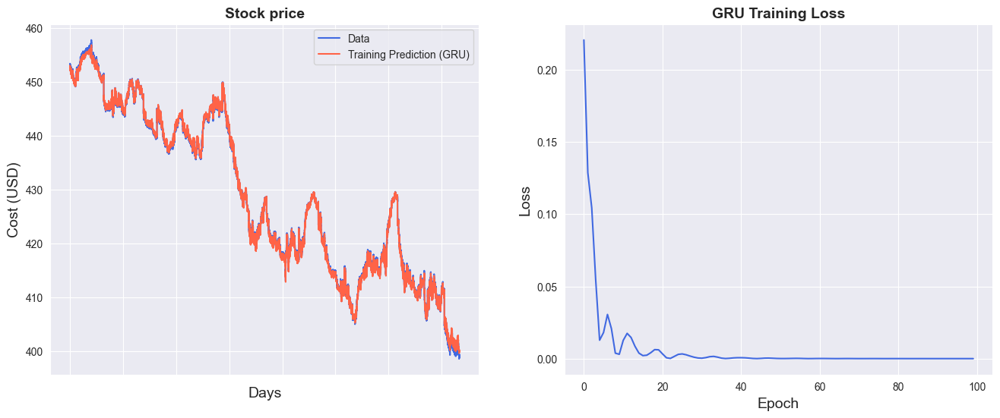

In [78]:

sns.set_style("darkgrid")    

fig = plt.figure()
fig.subplots_adjust(hspace=0.2, wspace=0.2)

plt.subplot(1, 2, 1)
ax = sns.lineplot(x = original.index, y = original[0], label="Data", color='royalblue')
ax = sns.lineplot(x = predict.index, y = predict[0], label="Training Prediction (GRU)", color='tomato')
ax.set_title('Stock price', size = 14, fontweight='bold')
ax.set_xlabel("Days", size = 14)
ax.set_ylabel("Cost (USD)", size = 14)
ax.set_xticklabels('', size=10)


plt.subplot(1, 2, 2)
ax = sns.lineplot(data=hist, color='royalblue')
ax.set_xlabel("Epoch", size = 14)
ax.set_ylabel("Loss", size = 14)
ax.set_title("GRU Training Loss", size = 14, fontweight='bold')
fig.set_figheight(6)
fig.set_figwidth(16)

In [79]:


# make predictions
y_test_pred = model(x_test)

# invert predictions
y_train_pred = scaler.inverse_transform(y_train_pred.detach().numpy())
y_train = scaler.inverse_transform(y_train_gru.detach().numpy())
y_test_pred = scaler.inverse_transform(y_test_pred.detach().numpy())
y_test = scaler.inverse_transform(y_test_gru.detach().numpy())

# calculate root mean squared error
trainScore = math.sqrt(mean_squared_error(y_train[:,0], y_train_pred[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(y_test[:,0], y_test_pred[:,0]))
print('Test Score: %.2f RMSE' % (testScore))
gru.append(trainScore)
gru.append(testScore)
gru.append(training_time)

Train Score: 0.26 RMSE
Test Score: 1.84 RMSE


In [80]:
# shift train predictions for plotting
trainPredictPlot = np.empty_like(price)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[lookback:len(y_train_pred)+lookback, :] = y_train_pred

# shift test predictions for plotting
testPredictPlot = np.empty_like(price)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(y_train_pred)+lookback-1:len(price)-1, :] = y_test_pred

original = scaler.inverse_transform(price['Price'].values.reshape(-1,1))

predictions = np.append(trainPredictPlot, testPredictPlot, axis=1)
predictions = np.append(predictions, original, axis=1)
result = pd.DataFrame(predictions)

In [81]:


fig = go2.Figure()
fig.add_trace(go2.Scatter(go2.Scatter(x=result.index, y=result[0],
                    mode='lines',
                    name='Train prediction')))
fig.add_trace(go2.Scatter(x=result.index, y=result[1],
                    mode='lines',
                    name='Test prediction'))
fig.add_trace(go2.Scatter(go2.Scatter(x=result.index, y=result[2],
                    mode='lines',
                    name='Actual Value')))
fig.update_layout(
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='white',
        linewidth=2,
        tickvals=date_plot_idx,
        ticktext=data['Date1'].loc[new_date_plot_idx].apply(lambda s : s.split(" ")[0])
    ),
    yaxis=dict(
        title_text='Close (USD)',
        titlefont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='white',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
    ),
    showlegend=True,
    template = 'plotly_dark'

)



annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                                xanchor='left', yanchor='bottom',
                                text='Results (GRU)',
                                font=dict(family='Rockwell',
                                        size=26,
                                        color='white'),
                                showarrow=False))
fig.update_layout(annotations=annotations)

fig.show()

In [82]:
lstm = pd.DataFrame(lstm, columns=['LSTM'])
gru = pd.DataFrame(gru, columns=['GRU'])
result = pd.concat([lstm, gru], axis=1, join='inner')
result.index = ['Train RMSE', 'Test RMSE', 'Train Time']
result

,LSTM,GRU
Train RMSE,0.167124,0.261216
Test RMSE,1.366104,1.838347
Train Time,940.033356,783.478790
